<a href="https://colab.research.google.com/github/SergiSalido/Reus-Bus-Transport-Network/blob/main/reus_bus_transport_network.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Reus Bus Transport Network Construction

## Import required modules

In [2]:
from google.colab import files
from bs4 import BeautifulSoup
import requests

## Create classes

In [3]:
class Bus_Stop:
  def __init__(self, _name, _number, _lines):
    self.name = _name
    self.number = _number
    self.lines = _lines

  def info(self):
    print('Name: ', self.name, '\nNumber: ', self.number, '\nLines: ', self.lines, '\n')


class Bus_Line:
  def __init__(self, _name, _number, _stops):
    self.name = _name
    self.number = _number
    self.stops = _stops

  def info(self):
    print('Name: ', self.name, '\nNumber: ', self.number, '\nStops: ', self.stops, '\n')

## Web scraping of bus stops data

In [4]:
# BUS STOPS

bus_stops_list = []

URL = 'https://rtp.amersam.net/stops'
page = requests.get(URL)
soup = BeautifulSoup(page.content, 'html.parser')

bus_stops = soup.find_all("li")[1:]
for bus_stop in bus_stops:
  # print(bus_stop)
  name = bus_stop.find("h3").text
  number = bus_stop.find("h5").text.replace('Parada: ', '')
  lines = [line['src'].replace('/media/img/', '').replace('.png', '') for line in bus_stop.find_all("img")]
  bus_stops_list.append(Bus_Stop(name, number, lines))

# for bus_stop in bus_stops_list:
#   bus_stop.info()

## Web scraping of bus lines data

In [5]:
# BUS LINES

bus_lines_list = []

URL = 'https://rtp.amersam.net/lines'
page = requests.get(URL)
soup = BeautifulSoup(page.content, 'html.parser')

bus_lines = soup.find_all("li")[1:]
for bus_line in bus_lines:
  name = bus_line.find("a", style="text-transform: uppercase;", href=True).text
  number = bus_line.find("a", style="text-transform: uppercase;", href=True).get("href").replace('/lines/', '')

  # BUS LINES STOPS SCHEMA
  URL = 'https://rtp.amersam.net/lines/' + number
  page = requests.get(URL)
  soup = BeautifulSoup(page.content, 'html.parser')
  
  bus_line_stops = soup.find_all("li")[2:]
  stops = [bus_line_stop.find("h5").text.replace('Parada: ', '') for bus_line_stop in bus_line_stops]
  bus_lines_list.append(Bus_Line(name, number, stops))

# for bus_line in bus_lines_list:
#   bus_line.info()

## Create the [Pajek NET format](https://gephi.org/users/supported-graph-formats/pajek-net-format) file

In [6]:
# Add nodes
pajek_format_text = '*Vertices ' + str(len(bus_stops_list)) + '\n'
id_dictionary = dict()
i = 1
for bus_stop in bus_stops_list:
  pajek_format_text += str(i) + ' ' + ' "' + bus_stop.number + '; ' + bus_stop.name + '"\n'
  id_dictionary[bus_stop.number] = i
  i=i+1


# Add edges
pajek_format_text += '*arcs\n'
edge_dict = dict()
for bus_line in bus_lines_list:
  for i in range(len(bus_line.stops)-1):
    edge = (id_dictionary.get(bus_line.stops[i]), id_dictionary.get(bus_line.stops[i+1]))
    if edge not in edge_dict:
      edge_dict[edge] = 1
    else:
      edge_dict[edge] += 1


for edge, weight in edge_dict.items():
  pajek_format_text += str(edge[0]) + ' ' + str(edge[1]) + ' ' + str(weight) + '\n'


# print(pajek_format_text)

## Save and download the [Pajek NET format](https://gephi.org/users/supported-graph-formats/pajek-net-format) file

In [7]:
with open('reus_bus_transport_network.net', 'w') as file:
    file.write(pajek_format_text)

files.download('reus_bus_transport_network.net')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Reus Bus Transport Network Analysis

## Import required modules

In [8]:
import networkx as nx
import numpy as np
import pandas as pd
from google.colab import data_table
data_table.enable_dataframe_formatter()
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import seaborn as sns
import os
from pathlib import Path

from bokeh.io import output_notebook, show, save
from bokeh.models import Range1d, Circle, ColumnDataSource, MultiLine
from bokeh.plotting import figure
from bokeh.plotting import from_networkx
from bokeh.palettes import Blues8, Reds8, Purples8, Oranges8, Viridis8, Spectral8
from bokeh.transform import linear_cmap

## Remove all isolates (nodes with no neighbors)

In [9]:
G = nx.parse_pajek(pajek_format_text)

# Get a list of all isolates of a graph
isolates = list(nx.isolates(G))
print('Isolates (nodes with no neighbors): ', isolates)

# Remove all isolates (nodes with no neighbors) in the graph
G.remove_nodes_from(list(nx.isolates(G)))

Isolates (nodes with no neighbors):  ['193; Cementiri bis', '226; Estadi Municipal 2', '60; Horticultura 1', '228; Horticultura 2', '217; Llapis 1', '218; Llapis 2']


## Save and download the [GraphML format](https://gephi.org/users/supported-graph-formats/graphml-format) file

In [10]:
nx.write_graphml_lxml(G, 'reus_bus_transport_network.graphml')
files.download('reus_bus_transport_network.graphml')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Network visualization

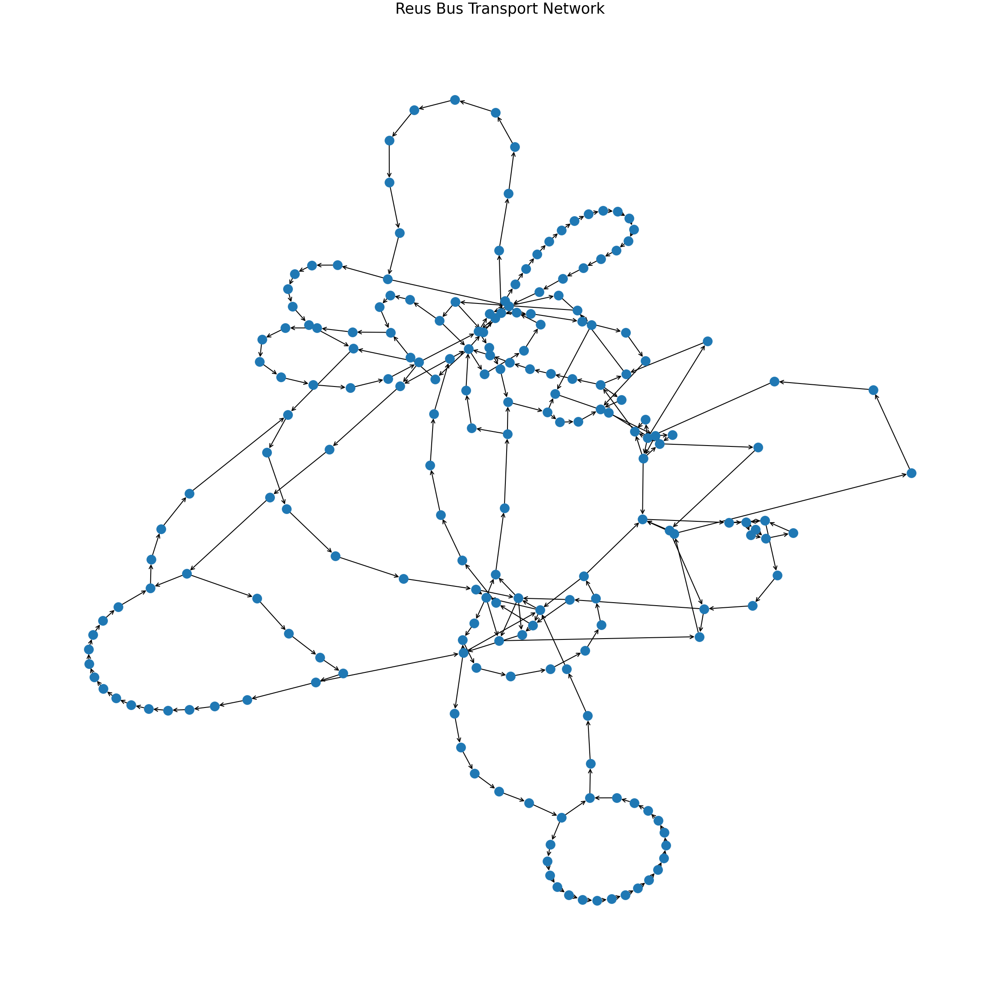

In [11]:
title = 'Reus Bus Transport Network'
fig = plt.figure(1, figsize=(60, 60), dpi=50)
plt.title(title, fontsize=50)
nx.draw(G,
        pos=nx.kamada_kawai_layout(G),
        node_size=1000,
        width=3,
        arrowstyle="->",
        arrowsize=30,
        edge_cmap=plt.cm.plasma)
plt.savefig(title + '.png', bbox_inches='tight')

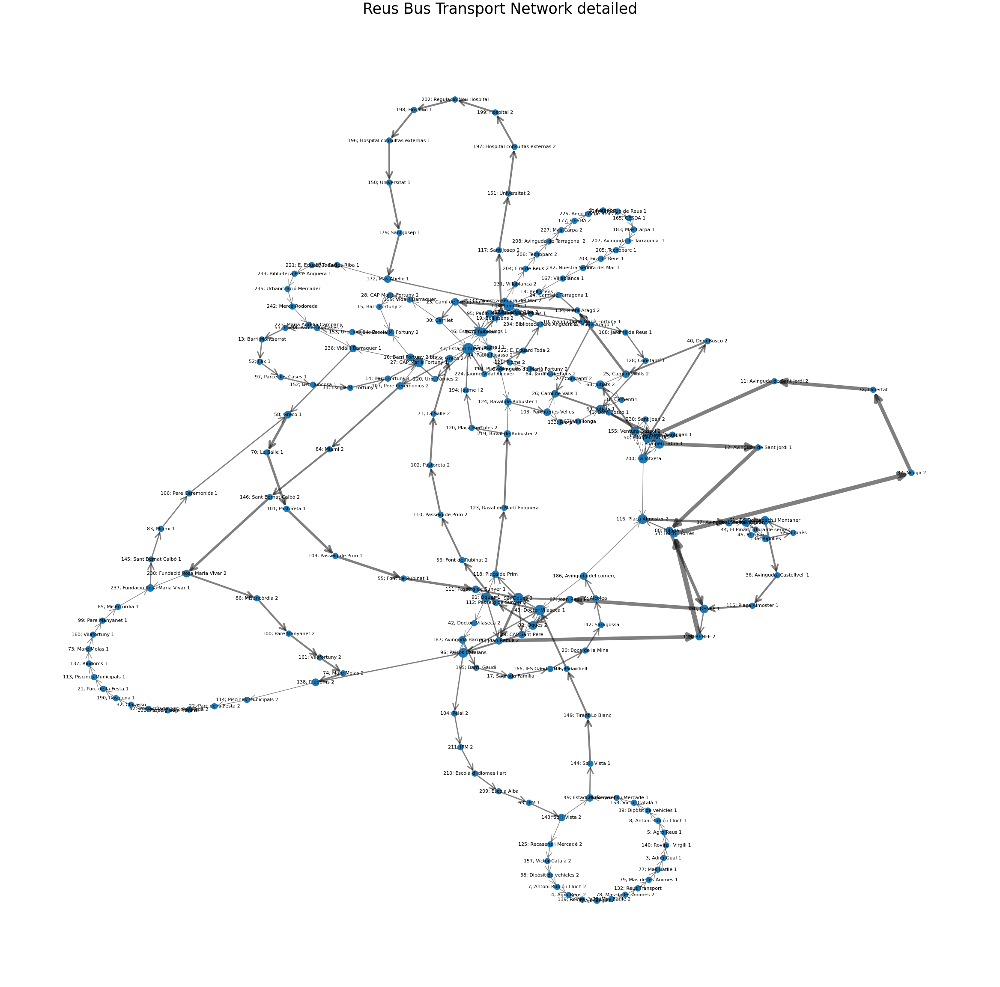

In [12]:
title = 'Reus Bus Transport Network detailed'
fig = plt.figure(figsize=(60, 60), dpi=50)
plt.title(title, fontsize=50)
plt.axis('off')

pos=nx.kamada_kawai_layout(G)

# edge_labels = dict([((u, v,), d['weight']) for u, v, d in G.edges(data=True)])
# nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels)

nodes, degrees = map(list, zip(*list(G.degree()))) # Build a node list and corresponding degree list
nx.draw_networkx_nodes(G,
                       pos,
                       nodelist=nodes,
                       node_size=[v * 200 for v in degrees])

edges = G.edges()
scaling_factor = 2 # To emphasise differences
widths = [data['weight'] * scaling_factor for node1, node2, data in G.edges(data=True)]
nx.draw_networkx_edges(G,
                       pos,
                       edgelist=edges,
                       arrowstyle="->",
                       arrowsize=50,
                       alpha=0.5,
                       width=widths)

nx.draw_networkx_labels(G, pos, font_size=16)

plt.savefig(title + '.png', bbox_inches='tight')

## Interactive Network Visualization with Bokeh

In [13]:
degrees = dict(nx.degree(G))
in_degrees = dict(G.in_degree)
out_degrees = dict(G.out_degree)
nx.set_node_attributes(G, name='degree', values=degrees)
nx.set_node_attributes(G, name='in_degree', values=in_degrees)
nx.set_node_attributes(G, name='out_degree', values=out_degrees)

number_to_adjust_by = 2
adjusted_node_size = dict([(node, degree*2+number_to_adjust_by) for node, degree in nx.degree(G)])
nx.set_node_attributes(G, name='adjusted_node_size', values=adjusted_node_size)

# Choose attributes from G network to size and color by — setting manual size (e.g. 10) or color (e.g. 'skyblue') also allowed
size_by_this_attribute = 'adjusted_node_size'
color_by_this_attribute = 'adjusted_node_size'

# Pick a color palette — Blues8, Reds8, Purples8, Oranges8, Viridis8
color_palette = Blues8

# Choose a title
title = 'Reus Bus Transport Network'

# Establish which categories will appear when hovering over each node
HOVER_TOOLTIPS = [
        ("Bus stop", "@index"),
        ("Degree", "@degree"),
        ("In-degree", "@in_degree"),
        ("Out-degree", "@out_degree")
        ]

# Create a plot — set dimensions, toolbar, and title
plot = figure(tooltips = HOVER_TOOLTIPS,
              tools="pan,wheel_zoom,save,reset", active_scroll='wheel_zoom',
            x_range=Range1d(-10.1, 10.1), y_range=Range1d(-10.1, 10.1), title=title)

# Create a network graph object
# https://networkx.github.io/documentation/networkx-1.9/reference/generated/networkx.drawing.layout.spring_layout.html\
network_graph = from_networkx(G, nx.kamada_kawai_layout, scale=10, center=(0, 0))

# Set node sizes and colors according to node degree (color as spectrum of color palette)
minimum_value_color = min(network_graph.node_renderer.data_source.data[color_by_this_attribute])
maximum_value_color = max(network_graph.node_renderer.data_source.data[color_by_this_attribute])
network_graph.node_renderer.glyph = Circle(size=size_by_this_attribute, fill_color=linear_cmap(color_by_this_attribute, color_palette, minimum_value_color, maximum_value_color))

# Set edge opacity and width
network_graph.edge_renderer.glyph = MultiLine(line_alpha=0.5, line_width=1)

plot.renderers.append(network_graph)

show(plot)
save(plot, filename=f"{title}.html")
# files.download(f"{title}.html")

/usr/local/lib/python3.7/dist-packages/bokeh/io/saving.py:126: UserWarning: save() called but no resources were supplied and output_file(...) was never called, defaulting to resources.CDN
  warn("save() called but no resources were supplied and output_file(...) was never called, defaulting to resources.CDN")
/usr/local/lib/python3.7/dist-packages/bokeh/io/saving.py:139: UserWarning: save() called but no title was supplied and output_file(...) was never called, using default title 'Bokeh Plot'
  warn("save() called but no title was supplied and output_file(...) was never called, using default title 'Bokeh Plot'")


'/content/Reus Bus Transport Network.html'

## Numerical descriptors of network

In [14]:
G = nx.DiGraph(G)

number_of_nodes = G.number_of_nodes()
number_of_edges = G.number_of_edges()
degrees = G.degree()
degrees_values = [val for (node, val) in degrees]
min_degree = min(degrees_values)
nodes_with_min_degree = [x[0] for x in degrees if x[1]==min_degree]
max_degree = max(degrees_values)
nodes_with_max_degree = [x[0] for x in degrees if x[1]==max_degree]
avg_degree = sum(degrees_values)/number_of_nodes
in_degrees = G.in_degree
in_degrees_values = [val for (node, val) in in_degrees]
min_in_degree = min(in_degrees_values)
max_in_degree = max(in_degrees_values)
avg_in_degree = sum(in_degrees_values)/number_of_nodes
out_degrees = G.out_degree
out_degrees_values = [val for (node, val) in out_degrees]
min_out_degree = min(out_degrees_values)
max_out_degree = max(out_degrees_values)
avg_out_degree = sum(out_degrees_values)/number_of_nodes
weighted_degrees = G.degree(weight='weight')
weighted_degrees_values = [val for (node, val) in weighted_degrees]
avg_weighted_degrees = sum(weighted_degrees_values)/number_of_nodes
weighted_in_degrees = G.in_degree(weight='weight')
weighted_in_degrees_values = [val for (node, val) in weighted_in_degrees]
avg_weighted_in_degrees = sum(weighted_in_degrees_values)/number_of_nodes
weighted_out_degrees = G.out_degree(weight='weight')
weighted_out_degrees_values = [val for (node, val) in weighted_out_degrees]
avg_weighted_out_degrees = sum(weighted_out_degrees_values)/number_of_nodes
density = nx.density(G)
average_clustering_coefficient = nx.average_clustering(G)
degree_assortativity_coefficient = nx.degree_assortativity_coefficient(G)
in_degree_assortativity_coefficient = nx.degree_assortativity_coefficient(G, x='in', y='in')
out_degree_assortativity_coefficient = nx.degree_assortativity_coefficient(G, x='out', y='out')
average_shortest_path_length = nx.average_shortest_path_length(G)
barycenter = nx.barycenter(G)
center = nx.center(G)
diameter = nx.diameter(G)
periphery = nx.periphery(G)
radius = nx.radius(G)
is_strongly_connected = nx.is_strongly_connected(G)
is_weakly_connected = nx.is_weakly_connected(G)
is_attracting_component = nx.is_attracting_component(G)

print(G)
print('Number of nodes: ', number_of_nodes)
print('Number of edges: ', number_of_edges)
print('Minimum degree: ', min_degree)
print('Bus stops with minimum degree: ', nodes_with_min_degree)
print('Maximum degree: ', max_degree)
print('Bus stops with maximum degree: ', nodes_with_max_degree)
print('Average degree: ', avg_degree)
print('Minimum in-degree: ', min_in_degree)
print('Maximum in-degree: ', max_in_degree)
print('Average in-degree: ', avg_in_degree)
print('Minimum out-degree: ', min_out_degree)
print('Maximum out-degree: ', max_out_degree)
print('Average out-degree: ', avg_out_degree)
print('Average weighted degree: ', avg_weighted_degrees)
print('Average weighted in-degree: ', avg_weighted_in_degrees)
print('Average weighted out-degree: ', avg_weighted_out_degrees)
print('Density: ', density)
print('Average clustering coefficient: ', average_clustering_coefficient)
print('Degree assortativity coefficient: ', degree_assortativity_coefficient)
print('In-degree assortativity coefficient: ', in_degree_assortativity_coefficient)
print('Out-degree assortativity coefficient: ', out_degree_assortativity_coefficient)
print('Average shortest path length: ', average_shortest_path_length)
print('Barycenter: ', barycenter)
print('Center: ', center)
print('Diameter: ', diameter)
print('Periphery: ', periphery)
print('Radius: ', radius)
print('Is strongly connected: ', is_strongly_connected)
print('Is weakly connected: ', is_weakly_connected)
print('Is attracting component: ', is_attracting_component)

DiGraph with 204 nodes and 250 edges
Number of nodes:  204
Number of edges:  250
Minimum degree:  2
Bus stops with minimum degree:  ['3; Adrià Gual 1', '2; Adrià Gual 2', '214; Aeroclub de Reus 1', '225; Aeroclub de Reus 2', '1; Aeroport', '5; Agro Reus 1', '4; Agro Reus 2', '6; Alcolea', '8; Antoni Rubió i Lluch 1', '7; Antoni Rubió i Lluch 2', '10; Avinguda de Marià Fortuny 1', '9; Avinguda de Marià Fortuny 2', '12; Avinguda de Sant Jordi 1', '11; Avinguda de Sant Jordi 2', '207; Avinguda de Tarragona  1', '208; Avinguda de Tarragona  2', '36; Avinguda. Castellvell 1', '195; Barri  Gaudi', '14; Barri Fortuny 1', '15; Barri Fortuny 2', '13; Barri Montserrat', '18; Bellissens 1', '19; Bellissens 2', '233; Biblioteca Pere Anguera 1', '234; Biblioteca Pere Anguera 2', '20; Boca de la Mina', '28; CAP Marià Fortuny 2', '165; CESDA 1', '177; CESDA 2', '24; Camí de Tarragona 1', '171; Carles Riba 1', '31; Cementiri', '32; Clarassó', '128; Constantí 1', '127; Constantí 2', '39; Dipòsit de veh

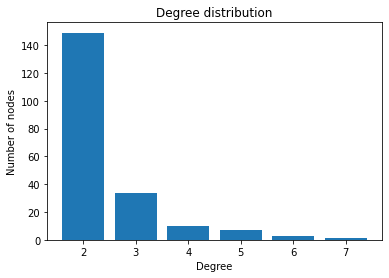

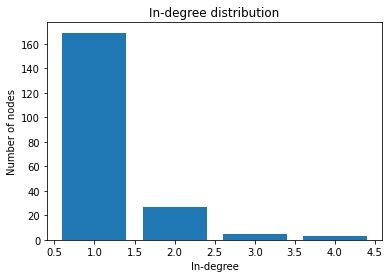

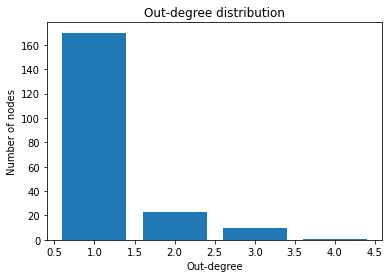

In [15]:
if not Path("/content/distributions").is_dir():
  os.mkdir('/content/distributions')

def degree_distribution_plot(measures, title, xlabel):
  plt.bar(*np.unique(measures, return_counts=True))
  plt.title(title)
  plt.xlabel(xlabel)
  plt.ylabel('Number of nodes')
  plt.savefig('distributions/' + title + '.png', bbox_inches='tight')
  plt.show()

degree_distribution_plot(degrees_values, 'Degree distribution', 'Degree')
degree_distribution_plot(in_degrees_values, 'In-degree distribution', 'In-degree')
degree_distribution_plot(out_degrees_values, 'Out-degree distribution', 'Out-degree')

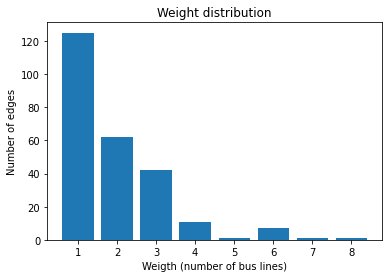

In [16]:
title = 'Weight distribution'
weights = nx.get_edge_attributes(G, "weight")
plt.bar(*np.unique(list(weights.values()), return_counts=True))
plt.title('Weight distribution')
plt.xlabel('Weigth (number of bus lines)')
plt.ylabel('Number of edges')
plt.savefig('distributions/' + title + '.png', bbox_inches='tight')
plt.show()

## Numerical descriptors of the nodes of the network

In [17]:
degrees = dict(degrees)
in_degrees = dict(in_degrees)
out_degrees = dict(out_degrees)
weighted_degrees = dict(weighted_degrees)
weighted_in_degrees = dict(weighted_in_degrees)
weighted_out_degrees = dict(weighted_out_degrees)
clustering_coefficient = nx.clustering(G)
pagerank = nx.pagerank(G)

descriptors=[]
for k in degrees:
  descriptors.append([k,
                  degrees[k],
                  in_degrees[k],
                  out_degrees[k],
                  weighted_degrees[k],
                  weighted_in_degrees[k],
                  weighted_out_degrees[k],
                  clustering_coefficient[k],
                  pagerank[k]])
descriptors_df=pd.DataFrame(descriptors, columns=['id',
                                 'Degree',
                                 'In-degree',
                                 'Out-degree',
                                 'Weighted degree',
                                 'Weighted in-degree',
                                 'Weighted out-degree',
                                 'Clustering coefficient',
                                 'Pagerank'])
descriptors_df

,id,Degree,In-degree,Out-degree,Weighted degree,Weighted in-degree,Weighted out-degree,Clustering coefficient,Pagerank
0,3; Adrià Gual 1,2,1,1,2.0,1.0,1.0,0.0,0.004560
1,2; Adrià Gual 2,2,1,1,2.0,1.0,1.0,0.0,0.003992
2,214; Aeroclub de Reus 1,2,1,1,2.0,1.0,1.0,0.0,0.004332
3,225; Aeroclub de Reus 2,2,1,1,2.0,1.0,1.0,0.0,0.004114
4,1; Aeroport,2,1,1,2.0,1.0,1.0,0.0,0.004232
...,...,...,...,...,...,...,...,...,...
199,160; Vilafortuny 1,2,1,1,2.0,1.0,1.0,0.0,0.004414
200,161; Vilafortuny 2,2,1,1,6.0,3.0,3.0,0.0,0.004259
201,162; Vilallonga,2,1,1,2.0,1.0,1.0,0.0,0.003053
202,167; Villablanca 1,2,1,1,2.0,1.0,1.0,0.0,0.004716


In [18]:
if not Path("/content/centralities").is_dir():
  os.mkdir('/content/centralities')

def draw(G, pos, measures, measure_name):
  fig = plt.figure(1, figsize=(50, 50), dpi=200)
  nodes = nx.draw_networkx_nodes(G, pos, node_size=400, cmap=plt.cm.plasma,
    node_color=list(measures.values()),
    nodelist=list(measures.keys()))
  nodes.set_norm(mcolors.SymLogNorm(linthresh=0.03, linscale=1))
  labels = nx.draw_networkx_labels(G, pos)
  edges = nx.draw_networkx_edges(G, pos)
  plt.title(measure_name, size=50)
  cbar = plt.colorbar(nodes)
  cbar.set_label('Centrality weight', rotation=0)
  plt.axis('off')
  plt.savefig('centralities/' + measure_name + '.png', bbox_inches='tight')
  plt.show()

degree_centrality = nx.degree_centrality(G)                     # Degree centrality of a node v is the fraction of nodes it is connected to
in_degree_centrality = nx.in_degree_centrality(G)               # In-degree centrality of a node v is the fraction of nodes its incoming edges are connected to
out_degree_centrality = nx.out_degree_centrality(G)             # Out-degree centrality of a node v is the fraction of nodes its outgoing edges are connected to
betweenness_centrality = nx.betweenness_centrality(G)           # Betweenness centrality of a node v is the sum of the fraction of all-pairs shortest paths that pass through v
closeness_centrality = nx.closeness_centrality(G)               # Closeness centrality of a node u is the reciprocal of the average shortest path distance to u over all n-1 reachable nodes
eigenvector_centrality = nx.eigenvector_centrality(G)           # Eigenvector centrality computes the centrality for a node based on the centrality of its neighbors
katz_centrality = nx.katz_centrality(G, alpha=0.1, beta=1.0)    # Katz centrality computes the centrality for a node based on the centrality of its neighbors. It is a generalization of the eigenvector centrality
harmonic_centrality = nx.harmonic_centrality(G)                 # Harmonic centrality of a node u is the sum of the reciprocal of the shortest path distances from all other nodes to u
load_centrality = nx.load_centrality(G)                         # Load centrality of a node is the fraction of all shortest paths that pass through that node

pos = nx.kamada_kawai_layout(G)
draw(G, pos, degree_centrality, 'Degree centrality')
draw(G, pos, in_degree_centrality, 'In-degree centrality')
draw(G, pos, out_degree_centrality, 'Out-degree centrality')
draw(G, pos, betweenness_centrality, 'Betweenness centrality')
draw(G, pos, closeness_centrality, 'Closeness centrality')
draw(G, pos, eigenvector_centrality, 'Eigenvector centrality')
draw(G, pos, katz_centrality, 'Katz centrality')
draw(G, pos, harmonic_centrality, 'Harmonic centrality')
draw(G, pos, load_centrality, 'Load centrality')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: MatplotlibDeprecationWarning: default base may change from np.e to 10.  To suppress this warning specify the base keyword argument.
  if __name__ == '__main__':


In [19]:
centralities=[]
for k in degree_centrality.keys():
  centralities.append([k,
                  degree_centrality[k],
                  in_degree_centrality[k],
                  out_degree_centrality[k],
                  betweenness_centrality[k],
                  closeness_centrality[k],
                  eigenvector_centrality[k],
                  katz_centrality[k],
                  harmonic_centrality[k],
                  load_centrality[k]])
centralities_df=pd.DataFrame(centralities, columns=['id',
                                 'Degree centrality',
                                 'In-degree centrality',
                                 'Out-degree centrality',
                                 'Betweenness centrality',
                                 'Clossness centrality',
                                 'Eigenvector centrality',
                                 'Katz centrality',
                                 'Harmonic centrality',
                                 'Load centrality'])
centralities_df

,id,Degree centrality,In-degree centrality,Out-degree centrality,Betweenness centrality,Clossness centrality,Eigenvector centrality,Katz centrality,Harmonic centrality,Load centrality
0,3; Adrià Gual 1,0.009852,0.004926,0.004926,0.084939,0.033487,0.000245,0.068060,9.525879,0.084939
1,2; Adrià Gual 2,0.009852,0.004926,0.004926,0.084939,0.040310,0.001897,0.068060,10.893664,0.084939
2,214; Aeroclub de Reus 1,0.009852,0.004926,0.004926,0.084939,0.040886,0.001739,0.068060,11.183048,0.084939
3,225; Aeroclub de Reus 2,0.009852,0.004926,0.004926,0.084939,0.043892,0.003439,0.068060,11.899724,0.084939
4,1; Aeroport,0.009852,0.004926,0.004926,0.084939,0.042336,0.002445,0.068060,11.522371,0.084939
...,...,...,...,...,...,...,...,...,...,...
199,160; Vilafortuny 1,0.009852,0.004926,0.004926,0.062137,0.030385,0.000036,0.068060,9.011566,0.062137
200,161; Vilafortuny 2,0.009852,0.004926,0.004926,0.122393,0.046379,0.004297,0.068060,12.774315,0.122220
201,162; Vilallonga,0.009852,0.004926,0.004926,0.022972,0.067599,0.026722,0.068067,17.250305,0.022972
202,167; Villablanca 1,0.009852,0.004926,0.004926,0.084939,0.032981,0.000159,0.068060,9.498627,0.084939


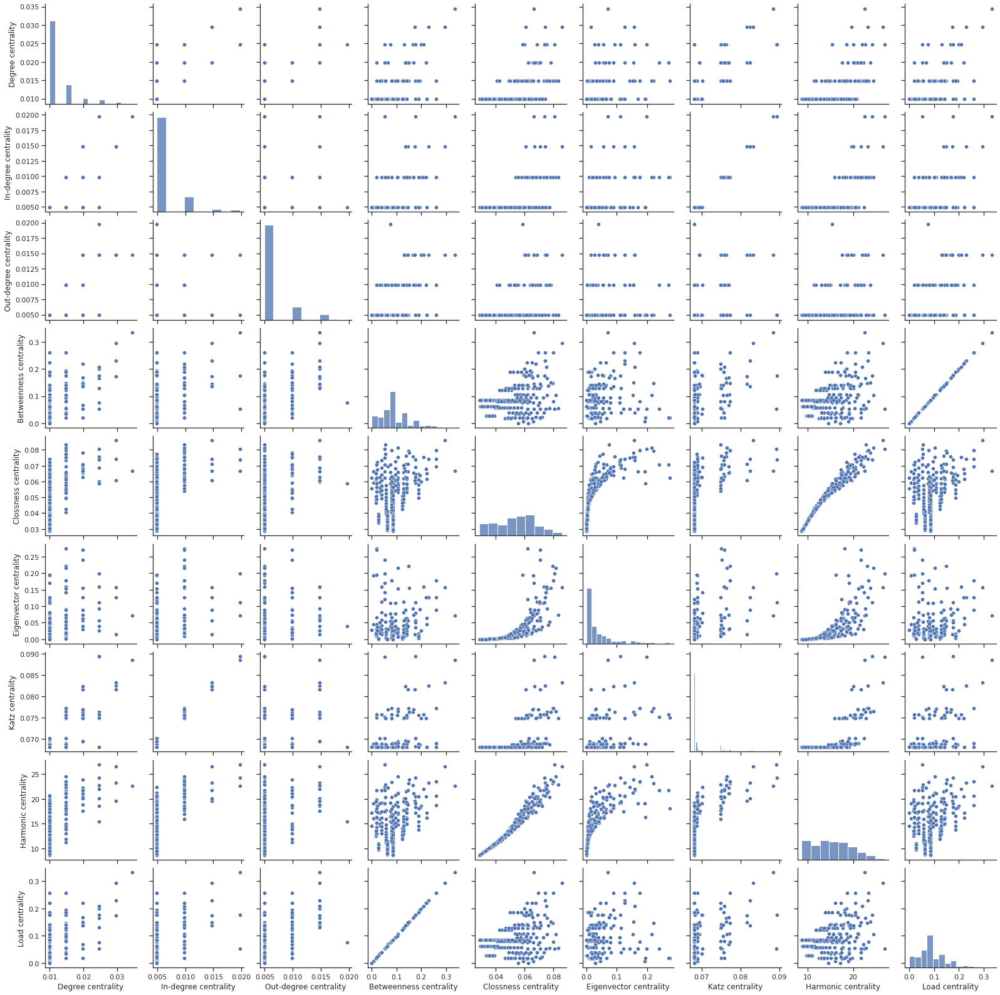

In [20]:
# Compare pairwise relationships of centralities
sns.set(style="ticks")
sns.pairplot(centralities_df)
plt.savefig('centralities/centralities_pairplot.png', bbox_inches='tight')

## Shortest path analysis

In [24]:
if not Path("/content/short_paths").is_dir():
  os.mkdir('/content/short_paths')

# Shortest path mapping function 
def short_path_plot(G,source,target):
  print("Source：", source)
  print("Target：", target)
  path = nx.shortest_path(G, source, target)
  print("Shortest path：", path)
  path_length = nx.shortest_path_length(G, source, target)
  print("Shortest path length：", path_length)

  pos=nx.kamada_kawai_layout(G)
  fig = plt.figure(1, figsize=(40, 40), dpi=40)
  plt.title('Source: ' + source + '\nTarget:  ' + target + '\nShortest path length: ' + str(path_length), loc='left', fontsize=50)
  nx.draw(G,
        pos,
        node_size=500,
        width=2,
        arrowstyle="->",
        arrowsize=30)
  path_edges = list(zip(path,path[1:])) # Create shortest path edges
  nx.draw_networkx_nodes(G, pos, nodelist=path, node_color='r', label=True) # Draw nodes
  nx.draw_networkx_edges(G, pos, edgelist=path_edges, edge_color='r', arrowstyle="->", arrowsize=30, width=7) # Draw edges
  plt.savefig('short_paths/' + source + '_' + target + '.png', bbox_inches='tight')
  plt.show()
  plt.clf()
  return

### Shortest path from source node to target node

Source： 23; Camí de Tarragona 2
Target： 130; RENFE 1
Shortest path： ['23; Camí de Tarragona 2', '30; Carrilet', '47; Estació Autobusos 2', '224; Jaume Vidal Alcover', '222; E. Eduard Toda 2', '234; Biblioteca Pere Anguera 2', '170; Carles Riba 2', '148; Tanatori 1', '24; Camí de Tarragona 1', '135; Riera Aragó 1', '26; Camí de Valls 1', '41; Dom Bosco 1', '51; Pompeu Fabra 1', '12; Avinguda de Sant Jordi 1', '88; Niloga 1', '130; RENFE 1']
Shortest path length： 15


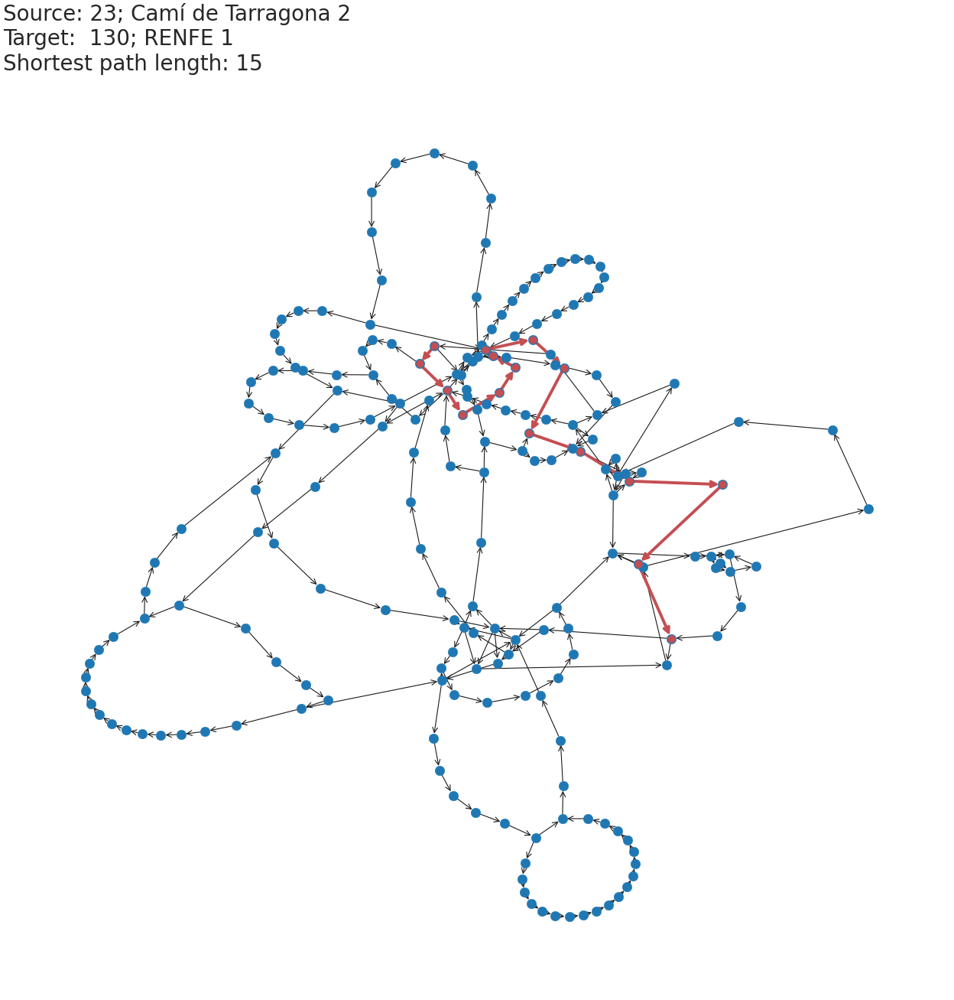

<Figure size 432x288 with 0 Axes>

In [38]:
# Plot shortest path
source = '23; Camí de Tarragona 2'    # Choose a bus stop as the starting point
target = '130; RENFE 1'               # Choose a bus stop as the ending point
short_path_plot(G, source, target)

### Shortest path lengths from source node to all target nodes

In [29]:
source = '23; Camí de Tarragona 2'  # Choose a bus stop as the starting point
lengths = list(nx.shortest_path_length(G, source).items())
df = pd.DataFrame(lengths, columns=['Target bus stop','Shortest path length']).sort_values(by='Shortest path length',ascending=False)
df

,Target bus stop,Shortest path length
203,126; Recasens i Mercade 1,40
202,158; Victor Català 1,39
201,39; Dipòsit de vehicles 1,38
200,8; Antoni Rubió i Lluch 1,37
199,5; Agro Reus 1,36
...,...,...
4,75; Mas Abelló 2,2
3,47; Estació Autobusos 2,2
2,147; Tanatori 2,1
1,30; Carrilet,1


### Shortest path lengths histograms

/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


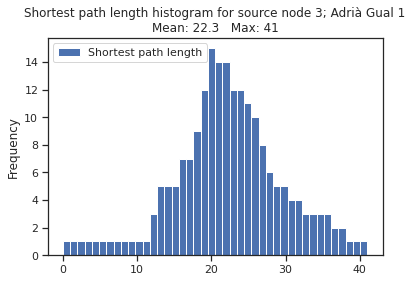

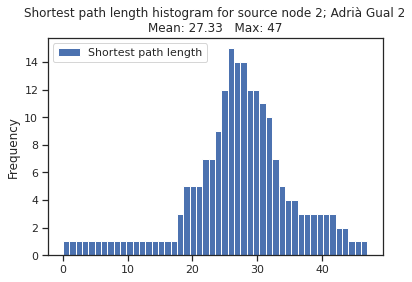

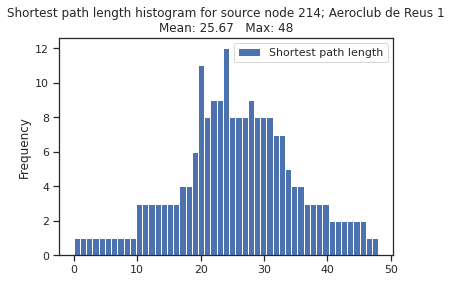

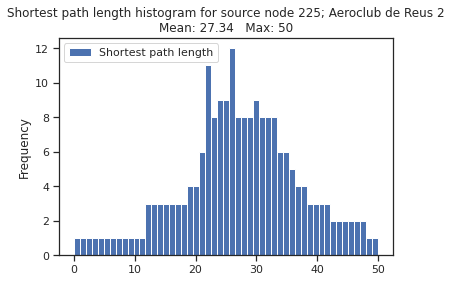

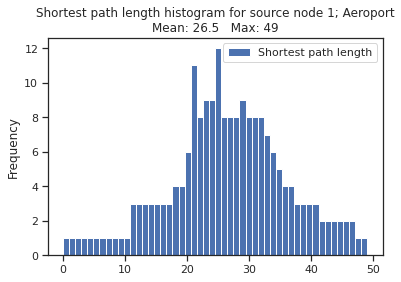

...

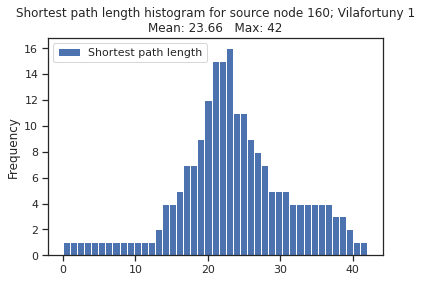

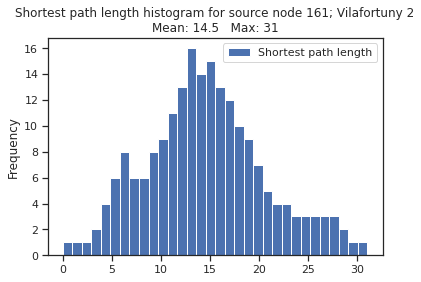

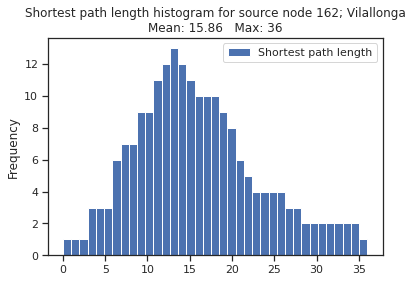

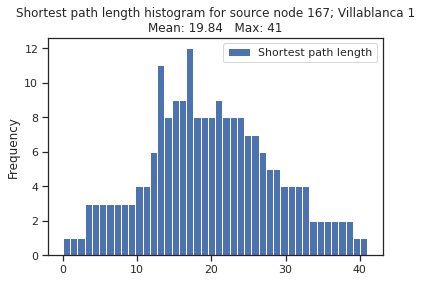

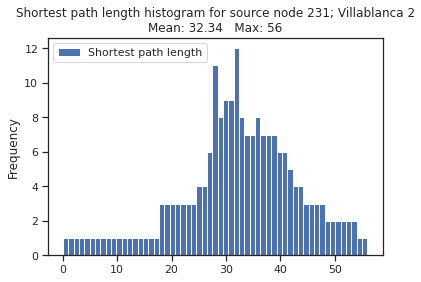

In [30]:
if not Path("/content/shortest_path_length_histograms").is_dir():
  os.mkdir('/content/shortest_path_length_histograms')

shortest_path_length_stats_df = pd.DataFrame(columns=['id',
                                                      'Mean shortest path length',
                                                      'Max shortest path length',
                                                      'Target with max shortest path length'])
for source, target_with_path_length in list(nx.shortest_path_length(G)):
  df = pd.DataFrame(target_with_path_length.items(),
                    columns=['Target bus stop','Shortest path length']).sort_values(by='Shortest path length',
                    ascending=False)
  max_shortest_path_length = df['Shortest path length'].max()
  mean_shortest_path_length = df['Shortest path length'].mean()
  shortest_path_length_stats_df = shortest_path_length_stats_df.append({'id': source,
                                                                        'Mean shortest path length': round(mean_shortest_path_length, 2),
                                                                        'Max shortest path length': max_shortest_path_length,
                                                                        'Target with max shortest path length':df[df['Shortest path length'] == max_shortest_path_length]['Target bus stop'].to_list()}, ignore_index=True)
  fig = df.plot.hist(bins=max_shortest_path_length+1,
                    title='Shortest path length histogram for source node '+str(source)+'\nMean: '+str(round(mean_shortest_path_length, 2))+'   Max: '+str(max_shortest_path_length))
  plt.savefig('shortest_path_length_histograms/' + source + '.png', bbox_inches='tight')

In [31]:
shortest_path_length_stats_df

,id,Mean shortest path length,Max shortest path length,Target with max shortest path length
0,3; Adrià Gual 1,22.30,41,[85; Misercòrdia 1]
1,2; Adrià Gual 2,27.33,47,[85; Misercòrdia 1]
2,214; Aeroclub de Reus 1,25.67,48,[85; Misercòrdia 1]
3,225; Aeroclub de Reus 2,27.34,50,[85; Misercòrdia 1]
4,1; Aeroport,26.50,49,[85; Misercòrdia 1]
...,...,...,...,...
199,160; Vilafortuny 1,23.66,42,[73; Mare Molas 1]
200,161; Vilafortuny 2,14.50,31,[18; Bellissens 1]
201,162; Vilallonga,15.86,36,[85; Misercòrdia 1]
202,167; Villablanca 1,19.84,41,[85; Misercòrdia 1]


## Save node descriptors

In [35]:
node_descriptors_df = pd.merge(pd.merge(descriptors_df, centralities_df, on='id'), shortest_path_length_stats_df, on='id').drop('Target with max shortest path length', axis=1)
node_descriptors_df.to_csv('node_descriptors.csv')
node_descriptors_df

,id,Degree,In-degree,Out-degree,Weighted degree,Weighted in-degree,Weighted out-degree,Clustering coefficient,Pagerank,Degree centrality,In-degree centrality,Out-degree centrality,Betweenness centrality,Clossness centrality,Eigenvector centrality,Katz centrality,Harmonic centrality,Load centrality,Mean shortest path length,Max shortest path length
0,3; Adrià Gual 1,2,1,1,2.0,1.0,1.0,0.0,0.004560,0.009852,0.004926,0.004926,0.084939,0.033487,0.000245,0.068060,9.525879,0.084939,22.30,41
1,2; Adrià Gual 2,2,1,1,2.0,1.0,1.0,0.0,0.003992,0.009852,0.004926,0.004926,0.084939,0.040310,0.001897,0.068060,10.893664,0.084939,27.33,47
2,214; Aeroclub de Reus 1,2,1,1,2.0,1.0,1.0,0.0,0.004332,0.009852,0.004926,0.004926,0.084939,0.040886,0.001739,0.068060,11.183048,0.084939,25.67,48
3,225; Aeroclub de Reus 2,2,1,1,2.0,1.0,1.0,0.0,0.004114,0.009852,0.004926,0.004926,0.084939,0.043892,0.003439,0.068060,11.899724,0.084939,27.34,50
4,1; Aeroport,2,1,1,2.0,1.0,1.0,0.0,0.004232,0.009852,0.004926,0.004926,0.084939,0.042336,0.002445,0.068060,11.522371,0.084939,26.50,49
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199,160; Vilafortuny 1,2,1,1,2.0,1.0,1.0,0.0,0.004414,0.009852,0.004926,0.004926,0.062137,0.030385,0.000036,0.068060,9.011566,0.062137,23.66,42
200,161; Vilafortuny 2,2,1,1,6.0,3.0,3.0,0.0,0.004259,0.009852,0.004926,0.004926,0.122393,0.046379,0.004297,0.068060,12.774315,0.122220,14.50,31
201,162; Vilallonga,2,1,1,2.0,1.0,1.0,0.0,0.003053,0.009852,0.004926,0.004926,0.022972,0.067599,0.026722,0.068067,17.250305,0.022972,15.86,36
202,167; Villablanca 1,2,1,1,2.0,1.0,1.0,0.0,0.004716,0.009852,0.004926,0.004926,0.084939,0.032981,0.000159,0.068060,9.498627,0.084939,19.84,41
